In [2]:
import torch
import numpy as np
import Dataset
import importlib
import matplotlib.pyplot as plt
import matplotlib
import networkx as nx

get_cmap = matplotlib.colormaps.get_cmap

importlib.reload(Dataset)
EventContainer   = Dataset.EventContainer
DatasetContainer = Dataset.DatasetContainer
GraphDatasetContainer = Dataset.GraphDatasetContainer
LSTMProcessingDatasetContainer = Dataset.LSTMProcessingDatasetContainer


def PLTParams(figsize = [20,20]):
    plt.rcParams['figure.figsize']=figsize
    plt.rcParams['font.size']=15
PLTParams()



In [3]:
DataPath = '/remote/tychodata/ftairli/data/Simulations__libraries__MCTask__Offline_v3r99p2a__IdealMC_CORSIKA__Hybrid_CORSIKA76400/SIB23c/DatasetFiles/RawData/'
NormDataPath = '/remote/tychodata/ftairli/data/Simulations__libraries__MCTask__Offline_v3r99p2a__IdealMC_CORSIKA__Hybrid_CORSIKA76400/SIB23c/DatasetFiles/NormData/'


In [9]:
T = torch.arange(5)
print(T[:10])

tensor([0, 1, 2, 3, 4])


In [29]:
# Importing Dataset
dataset = DatasetContainer(100)
dataset.Load(DataPath,'Test')
dataset.LoadTraces(DataPath,'Test')

In [4]:
# Getting Event and Some data from it
Event            = dataset.GetEventsByIndex(0)
# Event            = dataset.GetEventsByIndex(23)
# Event              = dataset.GetEventsByIndex(7)
PixelObservables = Event.PixelObservables
Traces           = PixelObservables.GetPixelTrace
Phi              = PixelObservables.PixelPhi
Theta            = PixelObservables.PixelTheta
PulseCentroid    = PixelObservables.PulseCentroid
Charge           = PixelObservables.Charge

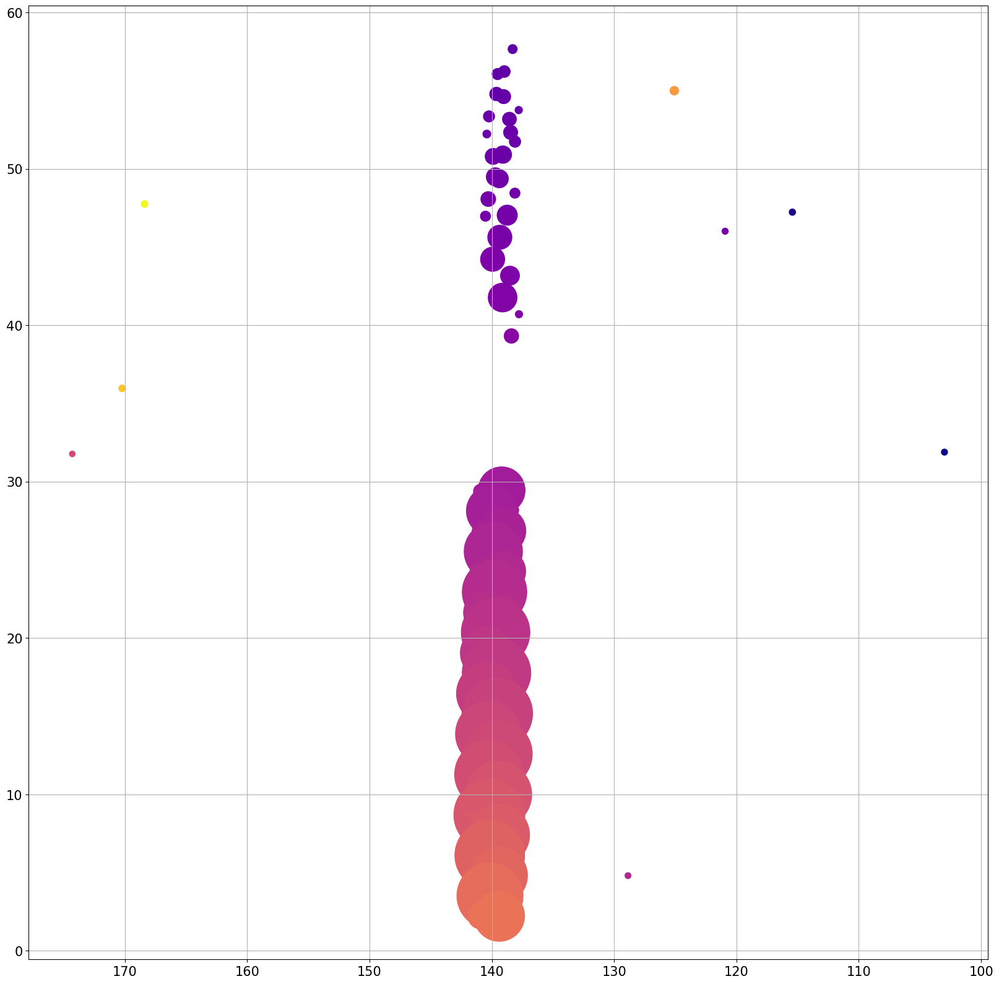

In [5]:
fig = plt.figure(figsize = (20,20))
size = Charge/10
offset = 30
plt.scatter(Phi,90-Theta,c=PulseCentroid,cmap='plasma',s=size)
plt.grid()
x_center = (plt.xlim()[0] + plt.xlim()[1]) / 2  # Calculate the center of the x-axis
threshold = 30
if abs(x_center - plt.xlim()[0]) < threshold and abs(x_center - plt.xlim()[1]) < threshold:
    new_xlim = (x_center - threshold, x_center + threshold)
    plt.xlim(new_xlim)
# Invert x axis
plt.gca().invert_xaxis()
plt.show()


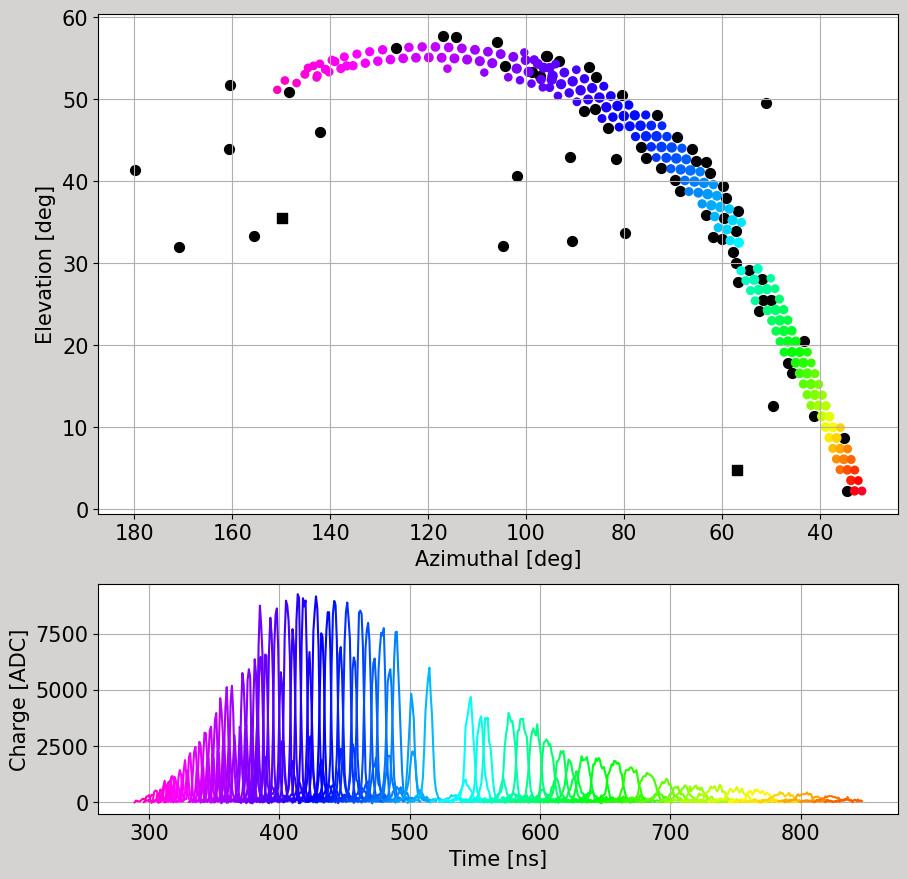

In [6]:
def PlotTraces(Event):
    # Get Data
    PixelObservables = Event.PixelObservables
    Traces           = PixelObservables.PixelTrace
    PixelTelID       = PixelObservables.TelID
    Phi              = PixelObservables.PixelPhi
    Theta            = PixelObservables.PixelTheta
    PulseCentroid    = PixelObservables.PulseCentroid
    Charge           = PixelObservables.Charge
    Status           = PixelObservables.Status
    PulseStart       = PixelObservables.PulseStart
    PulseStop        = PixelObservables.PulseStop
    Size             = 2*torch.log(Charge)
    TimeOffset       = PixelObservables.PixelTimeOffset


    cmap = get_cmap('gist_rainbow')

    PulseStart[PixelTelID>6] *= 0.5
    PulseStop[PixelTelID>6]  *= 0.5
    PulseStart = PulseStart.to(torch.int32)
    PulseStop  = PulseStop.to(torch.int32)

    # Make Axes
    fig = plt.figure(figsize = (10,10),facecolor='#d4d3d2')
    ax = fig.add_axes([0.1,0.4,0.8,0.5])
    ax.set_xlabel('Azimuthal [deg]')
    ax.set_ylabel('Elevation [deg]')

    # Plot Noise Pixels
    ax.scatter(Phi[Status==0],90-Theta[Status==0],c='black',s=50,marker='x',label='BackGround')
    ax.scatter(Phi[Status==1],90-Theta[Status==1],c='black',s=50,marker='s',label='Noise')
    ax.scatter(Phi[Status==2],90-Theta[Status==2],c='black',s=50,marker='o',label='NotUsed')
    ax.scatter(Phi[Status==3],90-Theta[Status==3],c=-PulseCentroid[Status==3],s=Size[Status==3]*2,marker='o',label='ChargeFit',cmap=cmap)
    ax.scatter(Phi[Status==4],90-Theta[Status==4],c=-PulseCentroid[Status==4],s=Size[Status==4]*2,marker='o',label='TimeFit',cmap=cmap)


    
    ax.grid()
    x_center = (ax.get_xlim()[0] + ax.get_xlim()[1]) / 2  # Calculate the center of the x-axis
    threshold = 30
    if abs(x_center - ax.get_xlim()[0]) < threshold and abs(x_center - ax.get_xlim()[1]) < threshold:
        new_xlim = (x_center - threshold, x_center + threshold)
        ax.set_xlim(new_xlim)
    # Invert x axis
    ax.invert_xaxis()
    
    # Cut the noise pixels
    Traces = Traces[Status>2]
    Phi    = Phi[Status>2]
    Theta  = Theta[Status>2]
    PulseCentroid = PulseCentroid[Status>2]
    Charge = Charge[Status>2]
    Size   = Charge/10
    PulseStart = PulseStart[Status>2]
    PulseStop  = PulseStop[Status>2]
    TimeOffset = TimeOffset[Status>2]
    # Plot Traces


    NormPulseCentroid = PulseCentroid.numpy()
    NormPulseCentroid -= NormPulseCentroid.min()
    NormPulseCentroid /= NormPulseCentroid.max()
    NormPulseCentroid *= -1
    NormPulseCentroid += 1
    NormPulseCentroid *= 0.9
    NormPulseCentroid += 0.1
    
    ax = fig.add_axes([0.1,0.1,0.8,0.23])
    for i in range(0,len(Traces)):
        Y = Traces[i][PulseStart[i]:PulseStop[i]]
        X = np.arange(PulseStart[i],PulseStop[i])+TimeOffset[i].item()
        
        ax.plot(X,Y,c = cmap(NormPulseCentroid[i]))
    ax.grid()
    ax.set_xlabel('Time [ns]')
    ax.set_ylabel('Charge [ADC]')


Event = dataset.GetEventsByIndex(7)
PlotTraces(Event)

/tmp/ipykernel_11010/1014503642.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(30,5))


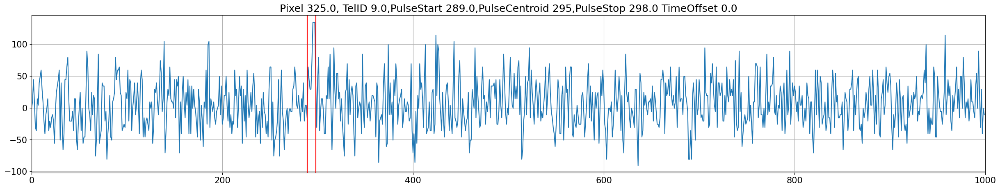

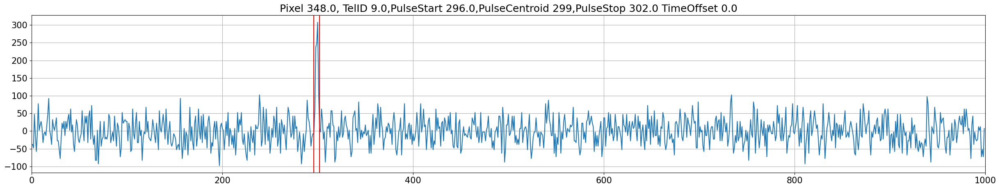

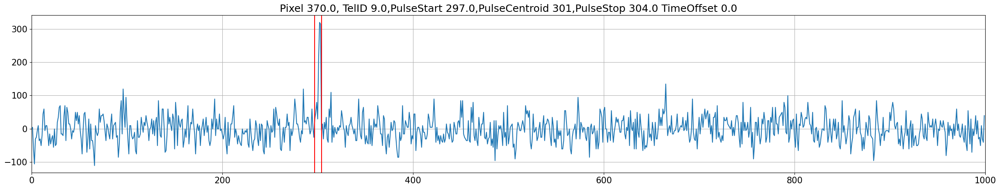

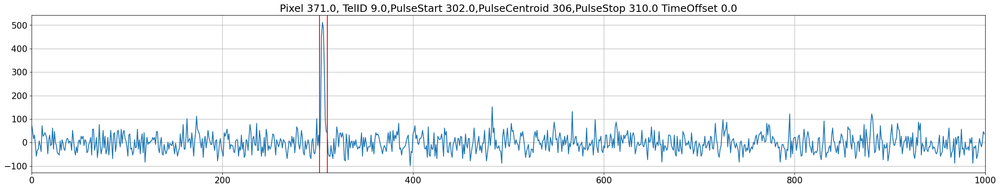

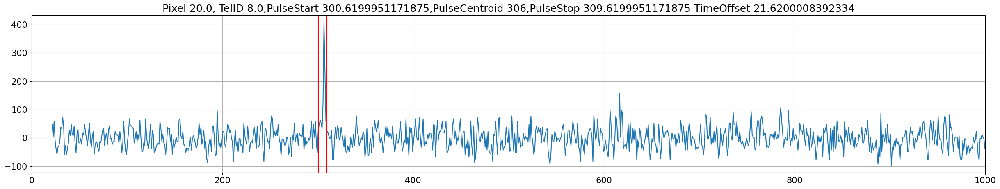

...

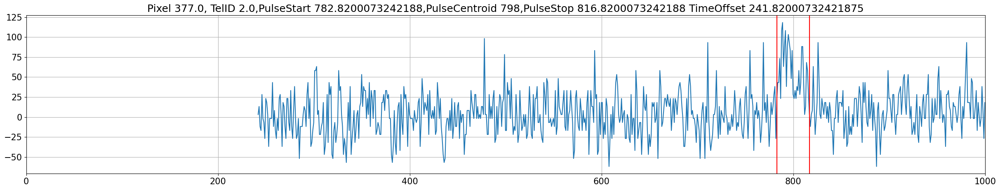

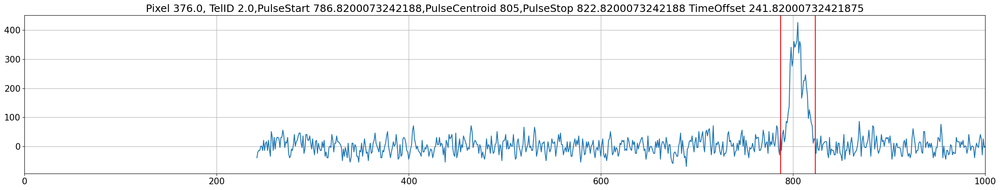

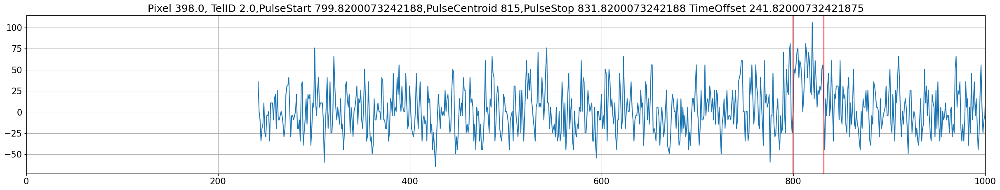

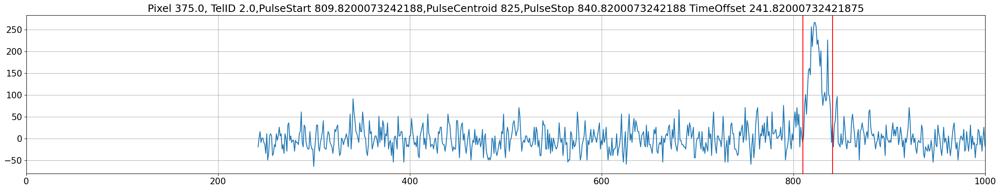

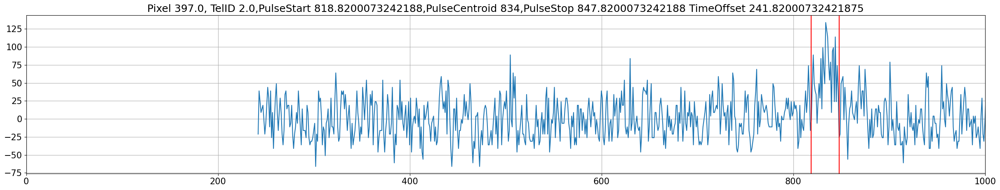

In [7]:
PixelObservables = Event.PixelObservables
PixelIDs         = PixelObservables.ID
PixelTelID       = PixelObservables.TelID
Traces           = PixelObservables.PixelTrace
PulseStart       = PixelObservables.PulseStart
PulseCentroid    = PixelObservables.PulseCentroid
PulseStop        = PixelObservables.PulseStop
Status           = PixelObservables.Status
TimeOffset       = PixelObservables.PixelTimeOffset

PulseStart[PixelTelID>6] *= 0.5
PulseStop[PixelTelID>6]  *= 0.5
PulseStart = PulseStart.to(torch.int32)
PulseStop  = PulseStop.to(torch.int32)

# Cut on status
PixelIDs = PixelIDs[Status>2]
PixelTelID = PixelTelID[Status>2]
Traces = Traces[Status>2]
PulseStart = PulseStart[Status>2]
PulseCentroid = PulseCentroid[Status>2]
PulseStop = PulseStop[Status>2]
TimeOffset = TimeOffset[Status>2]

Status = Status[Status>2]

# Plot Traces
for i in range(len(Traces)):
    if True:# PixelIDs[i] == 111:
        plt.figure(figsize=(30,5))
        plt.plot(np.arange(1000)+TimeOffset[i].item(),Traces[i])
        plt.axvline(PulseStart[i]+TimeOffset[i].item(),color='r')
        plt.axvline(PulseStop[i]+TimeOffset[i].item(),color='r')
        plt.title(f'Pixel {PixelIDs[i]}, TelID {PixelTelID[i]},PulseStart {PulseStart[i]+TimeOffset[i].item()},PulseCentroid {int(PulseCentroid[i])},PulseStop {PulseStop[i]+TimeOffset[i].item()} TimeOffset {TimeOffset[i]}')
        # plt.xlim(PulseStart[i]-50,PulseStop[i]+50)
        plt.xlim(0,1000)
        plt.grid()
# plt.bar(range(1000),Traces.sum(0))
# plt.plot(Traces.T)

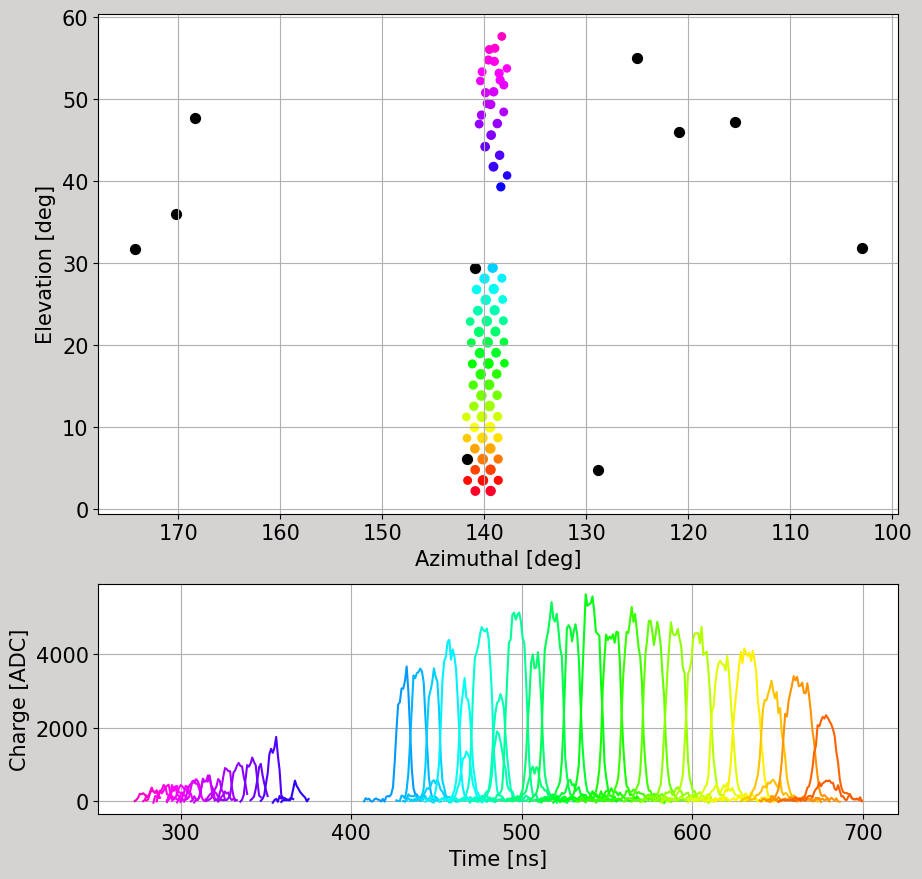

In [8]:
for i in range(1):
    Event = dataset.GetEventsByIndex(i)
    PlotTraces(Event)

In [9]:
import sys
sys.path.append('/remote/tychodata/ftairli/work/Projects/Recurrent_Geometry_Reconstruction/Code/')
from Training import GetAuxData, GetTruths, GetRecTruths

In [24]:
def GetTraces(dataset):
    assert dataset.HasTraces, 'Dataset doesnt have traces'
    shape = [len(dataset),1000,3]
    Traces = torch.zeros(shape) - 1
    
    
    for ev in range(len(dataset)):
        EvPixStart  = dataset._EventPixelPosition[ev,0]
        EvPixStop   = dataset._EventPixelPosition[ev,1]
        
        PulseStarts = dataset._pixelData[EvPixStart:EvPixStop,6]
        PulseStops  = dataset._pixelData[EvPixStart:EvPixStop,8]
        TimeOffsets = dataset._pixelData[EvPixStart:EvPixStop,11]
        Chis        = dataset._pixelData[EvPixStart:EvPixStop,5]
        TelIds      = dataset._pixelData[EvPixStart:EvPixStop,1]
        EyeIds      = dataset._pixelData[EvPixStart:EvPixStop,2]
        Status      = dataset._pixelData[EvPixStart:EvPixStop,3]
        EventTraces = dataset._pixelTraces[EvPixStart:EvPixStop]

        # Cut on Status 
        PulseStarts = PulseStarts[Status>2]
        PulseStops  = PulseStops[Status>2]
        TimeOffsets = TimeOffsets[Status>2]
        Chis        = Chis[Status>2]
        TelIds      = TelIds[Status>2]
        EyeIds      = EyeIds[Status>2]
        EventTraces = EventTraces[Status>2]
        Status      = Status[Status>2]

        # HeCo Events
        PulseStarts[TelIds>6] *= 0.5
        PulseStops[TelIds>6]  *= 0.5
        # HEAT Only Events
        PulseStarts[EyeIds == 5] *= 0.5
        PulseStops[EyeIds == 5]  *= 0.5
        PulseStarts = PulseStarts.to(torch.int32)
        PulseStops  = PulseStops.to(torch.int32)
        TimeOffsets = TimeOffsets.to(torch.int32)

        CombTraceStart = (PulseStarts+TimeOffsets).min().item()
        CombTraceStop  = (PulseStops+TimeOffsets).max().item()
        CombTrace      = torch.zeros(CombTraceStop-CombTraceStart)
        TraceChi       = torch.zeros(CombTraceStop-CombTraceStart)
        TraceChiW      = torch.zeros(CombTraceStop-CombTraceStart) # Will be weighed equally by the pixel count in the CombPulse
        for i in range(len(PulseStarts)):
            CombPulseStart = PulseStarts[i] + TimeOffsets[i] - CombTraceStart
            CombPulseStop  = PulseStops[i]  + TimeOffsets[i] - CombTraceStart
            CombTrace[CombPulseStart:CombPulseStop] += EventTraces[i][PulseStarts[i]:PulseStops[i]]
            TraceChi [CombPulseStart:CombPulseStop] += Chis[i] #*torch.clip(EventTraces[i][PulseStarts[i]:PulseStops[i]],0)
            TraceChiW[CombPulseStart:CombPulseStop] += 1       #torch.clip(EventTraces[i][PulseStarts[i]:PulseStops[i]],0)
            
        TraceChi[TraceChiW>0] /= TraceChiW[TraceChiW>0]
        
        # Normalise_Trace 
        CombTrace[CombTrace<=0] = -torch.log10(-CombTrace[CombTrace<=0] + 1)
        CombTrace[CombTrace>0]  = torch.log10(CombTrace[CombTrace>0] + 1)
        
        # Add to Traces 
        Traces[ev,-(CombTraceStop-CombTraceStart):,0] = CombTrace[-1000:]
        Traces[ev,-(CombTraceStop-CombTraceStart):,1] = TraceChi[-1000:]

        StationTime    = dataset.GetValues('StationTime')[ev]
        LastValue      = StationTime - CombTraceStop
        Traces[ev,:,2] = torch.arange(1000).flip(0) + LastValue
        Traces[ev,Traces[ev,:,0]==-1,2] = -1 
    return Traces


In [30]:
Run010 = DatasetContainer(100)
print('Loading')
Run010.Load(DataPath,'Run010')
# print('Loading Traces')
# Run010.LoadTraces(DataPath,'Run010')


Loading


Maximum Pulse Duration for Heat Pixles 107.0
Maximum Pulse Duration for non Heat Pixels 114.0


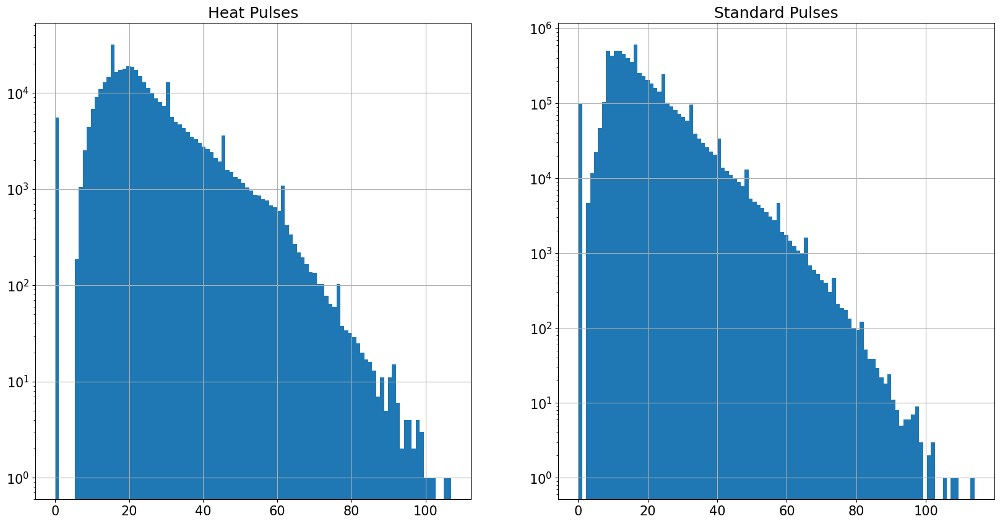

In [35]:
PulseStarts = Run010._pixelData[:,6]
PulseStops  = Run010._pixelData[:,8]
TelIds      = Run010._pixelData[:,1]
PulseDurations = PulseStops - PulseStarts

fig, axs = plt.subplots(1,2,figsize=(20,10))
X = np.array(PulseDurations[TelIds>6])
axs[0].hist(X,bins=100)
axs[0].set_yscale('log')
axs[0].grid()
axs[0].set_title('Heat Pulses')
print(f'Maximum Pulse Duration for Heat Pixles {X.max()}')

X = np.array(PulseDurations[TelIds<=6])
axs[1].hist(X,bins=100)
axs[1].set_yscale('log')
axs[1].grid()
axs[1].set_title('Standard Pulses')
print(f'Maximum Pulse Duration for non Heat Pixels {X.max()}')

In [25]:
Traces = GetTraces(dataset)
# Only look at 0th event
Traces = Traces[0].numpy()

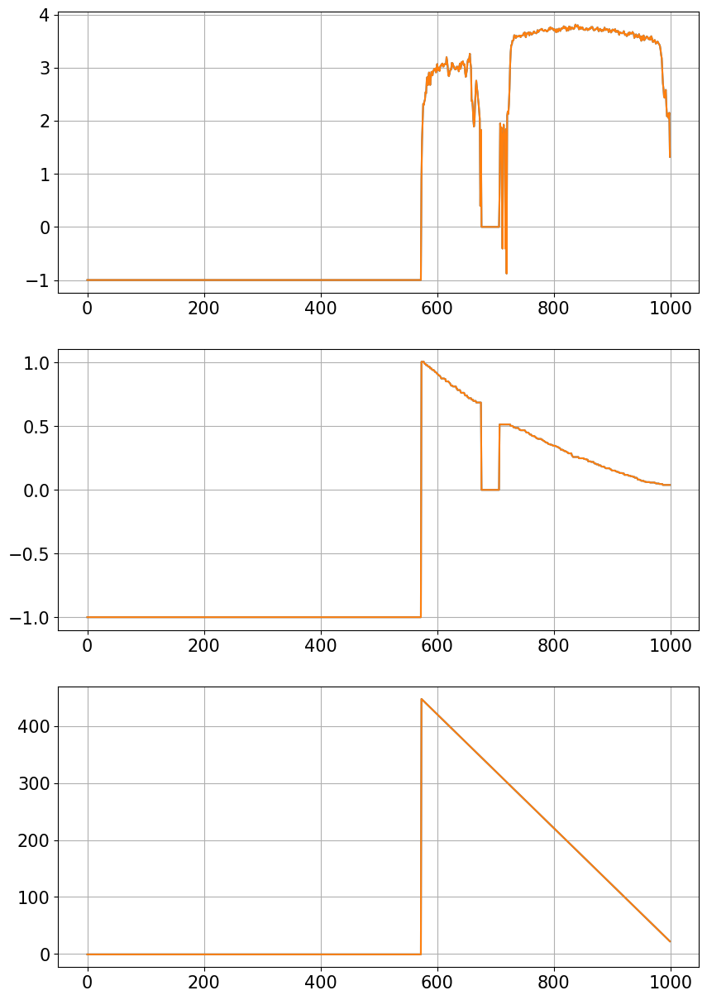

In [26]:
fig,axs = plt.subplots(Traces.shape[1],1,figsize = (10,Traces.shape[1]*5))
for i in range(Traces.shape[1]):
    axs[i].plot(Traces[:,i])
    axs[i].plot(Traces[:,i])
    axs[i].grid()


In [10]:
def GetTraces(dataset,StatusCut = 2):
    assert dataset.HasTraces, 'Dataset doesnt have traces'
    shape = [len(dataset),1000,4]
    Traces = torch.zeros(shape) - 1
    
    
    for ev in range(len(dataset)):
        EvPixStart  = dataset._EventPixelPosition[ev,0]
        EvPixStop   = dataset._EventPixelPosition[ev,1]
        
        PulseStarts = dataset._pixelData[EvPixStart:EvPixStop,6]
        PulseStops  = dataset._pixelData[EvPixStart:EvPixStop,8]
        TimeOffsets = dataset._pixelData[EvPixStart:EvPixStop,11]
        Phis        = dataset._pixelData[EvPixStart:EvPixStop,9]
        Thetas      = dataset._pixelData[EvPixStart:EvPixStop,10]
        Chis        = dataset._pixelData[EvPixStart:EvPixStop,5]
        TelIds      = dataset._pixelData[EvPixStart:EvPixStop,1]
        EyeIds      = dataset._pixelData[EvPixStart:EvPixStop,2]
        Status      = dataset._pixelData[EvPixStart:EvPixStop,3]
        EventTraces = dataset._pixelTraces[EvPixStart:EvPixStop]

        # Cut on Status # 0: Noise, 1: Background, 2: NotUsed, 3: ChargeFit, 4: TimeFit
        PulseStarts = PulseStarts[Status>StatusCut]
        PulseStops  = PulseStops[Status>StatusCut]
        TimeOffsets = TimeOffsets[Status>StatusCut]
        Chis        = Chis[Status>StatusCut]
        TelIds      = TelIds[Status>StatusCut]
        EyeIds      = EyeIds[Status>StatusCut]
        EventTraces = EventTraces[Status>StatusCut]
        Status      = Status[Status>StatusCut]

        # HeCo Events
        PulseStarts[TelIds>6] *= 0.5
        PulseStops[TelIds>6]  *= 0.5
        # HEAT Only Events
        PulseStarts[EyeIds == 5] *= 0.5
        PulseStops[EyeIds == 5]  *= 0.5
        PulseStarts = PulseStarts.to(torch.int32)
        PulseStops  = PulseStops.to(torch.int32)
        TimeOffsets = TimeOffsets.to(torch.int32)

        CombTraceStart = (PulseStarts+TimeOffsets).min().item()
        CombTraceStop  = (PulseStops+TimeOffsets).max().item()
        CombTrace      = torch.zeros(CombTraceStop-CombTraceStart)
        TracePhi       = torch.zeros(CombTraceStop-CombTraceStart)
        TraceTheta     = torch.zeros(CombTraceStop-CombTraceStart)
        TraceW      = torch.zeros(CombTraceStop-CombTraceStart) # Will be weighed equally by the pixel count in the CombPulse

        for i in range(len(PulseStarts)):
            CombPulseStart = PulseStarts[i] + TimeOffsets[i] - CombTraceStart
            CombPulseStop  = PulseStops[i]  + TimeOffsets[i] - CombTraceStart
            CombTrace [CombPulseStart:CombPulseStop] += EventTraces[i][PulseStarts[i]:PulseStops[i]]
            TracePhi  [CombPulseStart:CombPulseStop] += Phis[i]
            TraceTheta[CombPulseStart:CombPulseStop] += Thetas[i]
            TraceW    [CombPulseStart:CombPulseStop] += 1  
            
        TracePhi  [TraceW>0] /= TraceW[TraceW>0]
        TraceTheta[TraceW>0] /= TraceW[TraceW>0]
        
        # Normalise_Trace 
        CombTrace[CombTrace<=0] = -torch.log10(-CombTrace[CombTrace<=0] + 1)
        CombTrace[CombTrace>0]  = torch.log10(CombTrace[CombTrace>0] + 1)
        TracePhi/=180
        TraceTheta/=90
        # Add to Traces 
        Traces[ev,-(CombTraceStop-CombTraceStart):,0] = CombTrace[-1000:]
        Traces[ev,-(CombTraceStop-CombTraceStart):,1] = TracePhi[-1000:]
        Traces[ev,-(CombTraceStop-CombTraceStart):,2] = TraceTheta[-1000:]

        StationTime    = dataset.GetValues('StationTime')[ev]
        LastValue      = StationTime - CombTraceStop
        Traces[ev,:,3] = torch.arange(1000).flip(0) + LastValue
        Traces[ev,Traces[ev,:,0]==-1,3] = -1 
    return Traces


In [11]:
Traces = GetTraces(dataset)
# Only look at 0th event
Traces = Traces[0].numpy()

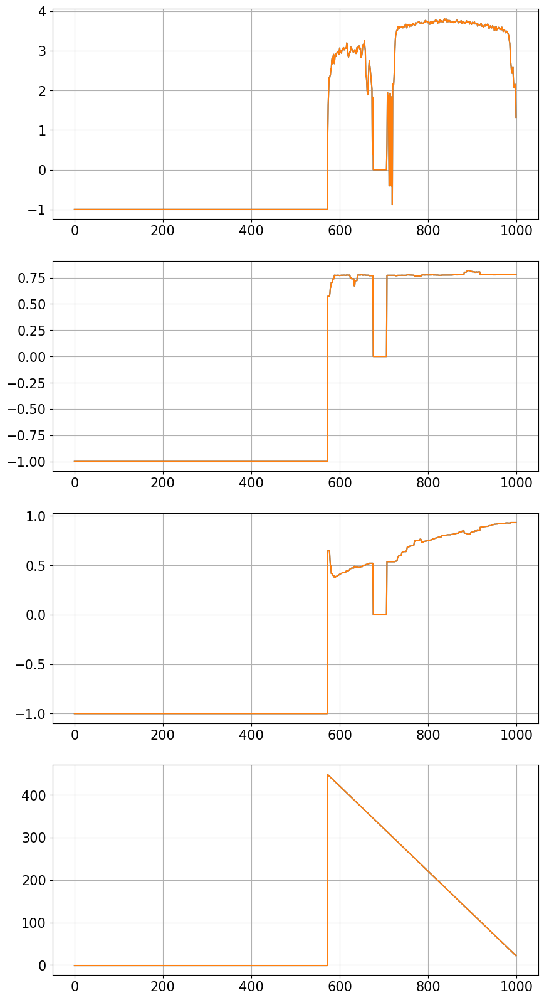

In [12]:
fig,axs = plt.subplots(Traces.shape[1],1,figsize = (10,Traces.shape[1]*5))
for i in range(Traces.shape[1]):
    axs[i].plot(Traces[:,i])
    axs[i].plot(Traces[:,i])
    axs[i].grid()


Truth Values are : [Chi0,Rp,SDPTheta,SDPPhi,logE,Xmax]


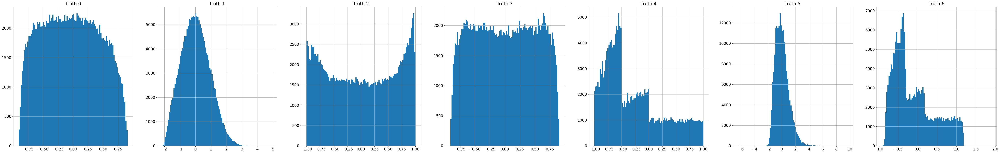

In [38]:
def GetTruths(Dataset):
    print(f'Truth Values are : [Chi0,Rp,SDPPhi,SDPTheta,logE,Xmax]')
    ALL_Chi0     = Dataset.GetValues('GenChi0')
    ALL_Rp       = Dataset.GetValues('GenRp')
    ALL_SDPPhi   = Dataset.GetValues('GenSDPPhi')
    ALL_SDPTheta = Dataset.GetValues('GenSDPTheta')
    ALL_logE     = Dataset.GetValues('GenLogE')
    ALL_Xmax     = Dataset.GetValues('GenXmax')
    ALL_dEdXmax  = Dataset.GetValues('Gen_dEdXmax')

    Norm_Chi0    = torch.cos(ALL_Chi0)
    Norm_Rp      = (ALL_Rp-12800)/5800
    NormSDPPhi   = torch.sin(ALL_SDPPhi)
    NormSDPTheta = torch.cos(ALL_SDPTheta)
    Norm_logE    = ALL_logE-19
    Norm_Xmax    = (ALL_Xmax-755)/66
    Norm_dEdXmax = torch.log10(ALL_dEdXmax)-1

    return torch.stack([Norm_Chi0,Norm_Rp,NormSDPPhi,NormSDPTheta,Norm_logE,Norm_Xmax,Norm_dEdXmax],1)

def UnnormaliseOutputs(Outputs):
    Norm_Chi0    = Outputs[:, 0]
    Norm_Rp      = Outputs[:, 1]
    NormSDPPhi   = Outputs[:, 2]
    NormSDPTheta = Outputs[:, 3]
    Norm_logE    = Outputs[:, 4]
    Norm_Xmax    = Outputs[:, 5]
    Norm_dEdXmax = Outputs[:, 6]

    ALL_Chi0     = torch.acos(Norm_Chi0)
    ALL_Rp       = Norm_Rp * 5800 + 12800
    ALL_SDPPhi   = torch.asin(NormSDPPhi)
    ALL_SDPTheta = torch.acos(NormSDPTheta)
    ALL_logE     = Norm_logE + 19
    ALL_Xmax     = Norm_Xmax * 66 + 755
    ALL_dEdXmax  = 10 ** (Norm_dEdXmax + 1)
    
    return torch.stack([ALL_Chi0, ALL_Rp, ALL_SDPPhi, ALL_SDPTheta, ALL_logE, ALL_Xmax], 1)


Truths = GetTruths(Run010).numpy()

fig, axs = plt.subplots(1,Truths.shape[1],figsize=(10*Truths.shape[1],10))
for i in range(Truths.shape[1]):
    axs[i].hist(Truths[:,i],bins=100)
    axs[i].grid()
    axs[i].set_title(f'Truth {i}')

Total Data Points : 18559


/tmp/ipykernel_17974/1253036230.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0].set_xticklabels([f"{x / np.pi * 180:.0f}°" for x in xticks])
/tmp/ipykernel_17974/1253036230.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0].set_yticklabels([f"{y / np.pi * 180:.0f}°" for y in yticks])
/tmp/ipykernel_17974/1253036230.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1].set_xticklabels([f"{x / np.pi * 180:.0f}°" for x in xticks])
/tmp/ipykernel_17974/1253036230.py:44: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1].set_yticklabels([f"{y / np.pi * 180:.0f}°" for y in yticks])


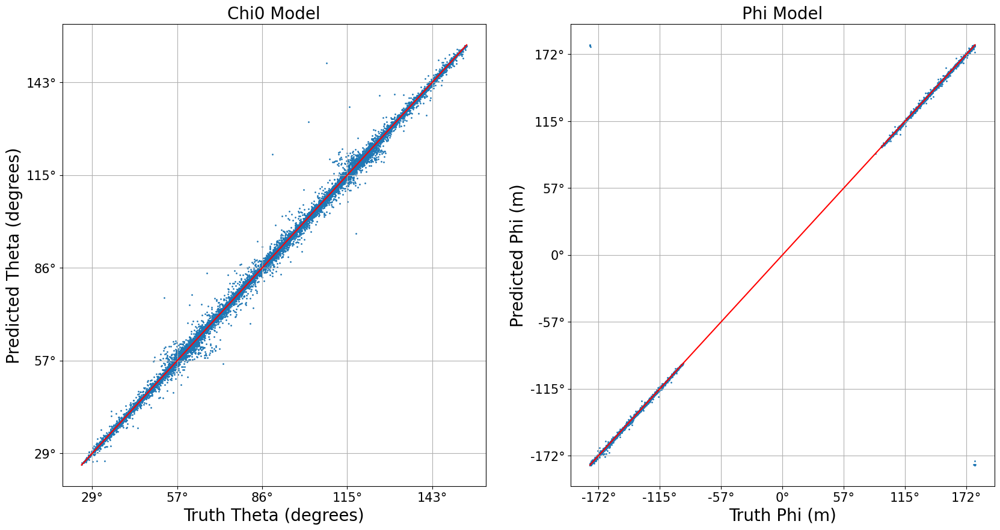

In [18]:
Theta_True = Run010.GetValues('GenSDPTheta')
Phi___True = Run010.GetValues('GenSDPPhi')

Theta_Rec  = Run010.GetValues('RecSDPTheta')
Phi___Rec  = Run010.GetValues('RecSDPPhi')

if True: # Decimate the data
    factor = 10
    Theta_True = Theta_True[::factor]
    Phi___True = Phi___True[::factor]
    Theta_Rec  = Theta_Rec[::factor]
    Phi___Rec  = Phi___Rec[::factor]
    print(f'Total Data Points : {len(Theta_True)}')


# Easy Scatter Plots of Truth vs Predicted
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

# Scatter plot for the first subplot
ax[0].scatter(Theta_True, Theta_Rec, s=1)
ax[0].plot([min(Theta_True), max(Theta_True)], [min(Theta_True), max(Theta_True)], 'r')
ax[0].set_xlabel('Truth Theta (degrees)',fontsize=20)
ax[0].set_ylabel('Predicted Theta (degrees)',fontsize=20)
ax[0].set_title('Chi0 Model',fontsize=20)

# Set x and y ticks for the first subplot
xticks = ax[0].get_xticks()
ax[0].set_xticklabels([f"{x / np.pi * 180:.0f}°" for x in xticks])
yticks = ax[0].get_yticks()
ax[0].set_yticklabels([f"{y / np.pi * 180:.0f}°" for y in yticks])
ax[0].grid()

# Scatter plot for the second subplot
ax[1].scatter(Phi___True, Phi___Rec, s=1)
ax[1].plot([min(Phi___True), max(Phi___True)], [min(Phi___True), max(Phi___True)], 'r')
ax[1].set_xlabel('Truth Phi (m)',fontsize=20)
ax[1].set_ylabel('Predicted Phi (m)',fontsize=20)
ax[1].set_title('Phi Model',fontsize=20)
# Set x and y ticks for the first subplot

xticks = ax[1].get_xticks()
ax[1].set_xticklabels([f"{x / np.pi * 180:.0f}°" for x in xticks])
yticks = ax[1].get_yticks()
ax[1].set_yticklabels([f"{y / np.pi * 180:.0f}°" for y in yticks])
ax[1].grid()


# plt.savefig(f'../Results/')

plt.show()


In [19]:
def compute_deviation(true_angle_rad, predicted_angle_rad):
    deviation_rad = torch.abs(torch.atan2(torch.sin(true_angle_rad - predicted_angle_rad), torch.cos(true_angle_rad - predicted_angle_rad)))
    return deviation_rad


Theta_Dev = compute_deviation(Theta_True, Theta_Rec)
Phi___Dev = compute_deviation(Phi___True, Phi___Rec)

def Percentile68(Truths,Predictions):
    return np.percentile(np.abs(Truths-Predictions),68) if type(Truths) != torch.Tensor else torch.quantile(torch.abs(Truths-Predictions),0.68)
def Percentile68_Dev(Deviation):
    return np.percentile(np.abs(Deviation),68) if type(Deviation) != torch.Tensor else torch.quantile(torch.abs(Deviation),0.68)


# Calculate the 68th percentile of the deviation
Theta_Dev_68 = Percentile68_Dev(Theta_Dev)*180/np.pi
Phi___Dev_68 = Percentile68_Dev(Phi___Dev)*180/np.pi

Theta_Dev_68 = Percentile68(Theta_True,Theta_Rec)*180/np.pi
Phi___Dev_68 = Percentile68(Phi___True,Phi___Rec)*180/np.pi


print(f'Theta Deviation 68th percentile: {Theta_Dev_68:.2f} degrees')
print(f'Phi Deviation 68th percentile: {Phi___Dev_68:.2f} degrees')


 

Theta Deviation 68th percentile: 0.54 degrees
Phi Deviation 68th percentile: 0.19 degrees


In [26]:
print(np.log10(23749013))

7.375645565221485
